In [1]:
!pip install -q -U google-generativeai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 163.1/163.1 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 717.3/717.3 kB 10.3 MB/s eta 0:00:00


In [2]:
!pip install llama_index

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.4/15.4 MB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.8/130.8 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 327.4/327.4 kB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 29.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 290.4/290.4 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 975.5 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.2/49.2 kB 3.2 MB/s eta 0:00:00


In [3]:
import google.generativeai as genai
import pathlib
import textwrap
from IPython.display import display
from IPython.display import Markdown

def to_markdown(text):
  text = text.replace('•', '  *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))


# Example usage:
input_text = "This is a • sample text with bullet points."
result = to_markdown(input_text)

display(result)


> This is a   * sample text with bullet points.

In [4]:
from google.colab import userdata

In [5]:
GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')

In [6]:
genai.configure(api_key=GOOGLE_API_KEY)

In [7]:
for models in genai.list_models():
  print(models)

Model(name='models/chat-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 Chat (Legacy)',
      description='A legacy text-only model optimized for chat conversations',
      input_token_limit=4096,
      output_token_limit=1024,
      supported_generation_methods=['generateMessage', 'countMessageTokens'],
      temperature=0.25,
      top_p=0.95,
      top_k=40)
Model(name='models/text-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 (Legacy)',
      description='A legacy model that understands text and generates text as an output',
      input_token_limit=8196,
      output_token_limit=1024,
      supported_generation_methods=['generateText', 'countTextTokens', 'createTunedTextModel'],
      temperature=0.7,
      top_p=0.95,
      top_k=40)
Model(name='models/embedding-gecko-001',
      base_model_id='',
      version='001',
      display_name='Embedding Gecko',
      description='Obtain a distributed representatio

In [8]:
for models in genai.list_models():
  if 'generateContent' in models.supported_generation_methods:
    print(models.name)

models/gemini-1.0-pro
models/gemini-1.0-pro-001
models/gemini-1.0-pro-latest
models/gemini-1.0-pro-vision-latest
models/gemini-1.5-flash
models/gemini-1.5-flash-001
models/gemini-1.5-flash-latest
models/gemini-1.5-pro
models/gemini-1.5-pro-001
models/gemini-1.5-pro-latest
models/gemini-pro
models/gemini-pro-vision


In [9]:
model=genai.GenerativeModel('gemini-pro')

In [10]:
%%time
response=model.generate_content("Who is maha rana pratab ?")

CPU times: user 116 ms, sys: 7.52 ms, total: 124 ms
Wall time: 7.68 s


In [11]:
to_markdown(response.text)

> **Maharana Pratap** (1540-1597) was a Rajput king of Mewar (present-day Rajasthan, India). He is renowned for his valiant resistance against the Mughal Empire and is considered one of India's greatest warriors.
> 
> **Early Life and Accession:**
> 
> * Born in 1540 as Udai Singh II, the eldest son of Maharana Udai Singh I.
> * Ascended to the throne of Mewar in 1572 after the death of his father.
> 
> **Conflict with the Mughals:**
> 
> * Refused to submit to the Mughal emperor Akbar's authority, unlike other Rajput kingdoms.
> * Led a prolonged guerrilla warfare against the Mughals for over 25 years.
> * Became known as "Maharana" (Grand King) due to his bravery and leadership.
> 
> **Battle of Haldighati (1576):**
> 
> * Fought a fierce battle against a superior Mughal army led by Man Singh I.
> * Though outnumbered, Pratap's forces inflicted heavy losses on the Mughals.
> * Although Pratap lost the battle, he escaped with his life and continued his resistance.
> 
> **Guerrilla Warfare:**
> 
> * Used guerrilla tactics to attack Mughal outposts and supply lines.
> * Established secret bases in the Aravalli Hills, making it difficult for the Mughals to defeat him.
> * Inspired other Rajput kingdoms to resist Mughal domination.
> 
> **Personal Life:**
> 
> * Known for his physical prowess and military skills.
> * Had multiple wives and many children.
> * His mother, Maharani Jaiwantabai, was a strong supporter and advisor.
> 
> **Legacy:**
> 
> * Considered a national hero in India.
> * His name is synonymous with bravery, sacrifice, and determination.
> * His resistance against the Mughals helped to preserve Rajput autonomy and identity.
> * Numerous monuments, forts, and institutions bear his name in his honor.

In [12]:
response.candidates

[content {
  parts {
    text: "**Maharana Pratap** (1540-1597) was a Rajput king of Mewar (present-day Rajasthan, India). He is renowned for his valiant resistance against the Mughal Empire and is considered one of India\'s greatest warriors.\n\n**Early Life and Accession:**\n\n* Born in 1540 as Udai Singh II, the eldest son of Maharana Udai Singh I.\n* Ascended to the throne of Mewar in 1572 after the death of his father.\n\n**Conflict with the Mughals:**\n\n* Refused to submit to the Mughal emperor Akbar\'s authority, unlike other Rajput kingdoms.\n* Led a prolonged guerrilla warfare against the Mughals for over 25 years.\n* Became known as \"Maharana\" (Grand King) due to his bravery and leadership.\n\n**Battle of Haldighati (1576):**\n\n* Fought a fierce battle against a superior Mughal army led by Man Singh I.\n* Though outnumbered, Pratap\'s forces inflicted heavy losses on the Mughals.\n* Although Pratap lost the battle, he escaped with his life and continued his resistance.\n\

In [13]:
response.parts

[text: "**Maharana Pratap** (1540-1597) was a Rajput king of Mewar (present-day Rajasthan, India). He is renowned for his valiant resistance against the Mughal Empire and is considered one of India\'s greatest warriors.\n\n**Early Life and Accession:**\n\n* Born in 1540 as Udai Singh II, the eldest son of Maharana Udai Singh I.\n* Ascended to the throne of Mewar in 1572 after the death of his father.\n\n**Conflict with the Mughals:**\n\n* Refused to submit to the Mughal emperor Akbar\'s authority, unlike other Rajput kingdoms.\n* Led a prolonged guerrilla warfare against the Mughals for over 25 years.\n* Became known as \"Maharana\" (Grand King) due to his bravery and leadership.\n\n**Battle of Haldighati (1576):**\n\n* Fought a fierce battle against a superior Mughal army led by Man Singh I.\n* Though outnumbered, Pratap\'s forces inflicted heavy losses on the Mughals.\n* Although Pratap lost the battle, he escaped with his life and continued his resistance.\n\n**Guerrilla Warfare:**\

In [14]:
response.prompt_feedback

In [15]:
%%time
response=model.generate_content("what is the meaning of life ?",stream=True)
for chunk in response:
  print(chunk.text)
  print("_"*80)

**Philosophical Perspectives on the Meaning of Life:**

* **Existentialism
________________________________________________________________________________
:** Focuses on individual freedom and responsibility, suggesting that life has no inherent meaning and that each person must create their own.
* **Nihilism:**
________________________________________________________________________________
 Believes that life is inherently meaningless and without purpose.
* **Absurdism:** Acknowledges the absurdity of the human condition but suggests that it is up to individuals to find meaning in their own suffering.
* **Stoicism:** Emphasizes the importance of accepting life's challenges and finding tranquility through reason
________________________________________________________________________________
 and virtue.
* **Hedonism:** Considers pleasure and happiness to be the ultimate goals of life.
* **Teleology:** Suggests that life has a predetermined purpose or goal.

**Religious and Spiritual

In [16]:
!curl -o image.jpg https://t0.gstatic.com/licensed-image?q=tbn:ANd9GcQ_Kevbk21QBRy-PgB4kQpS79brbmmEG7m3VOTShAn4PecDU5H5UxrJxE3Dw1JiaG17V88QIol19-3TM2wCHw


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  405k  100  405k    0     0  5587k      0 --:--:-- --:--:-- --:--:-- 5625k


In [17]:
!curl -o image2.jpg https://images.pexels.com/photos/414612/pexels-photo-414612.jpeg?cs=srgb&dl=pexels-james-wheeler-414612.jpg&fm=jpg


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1499k  100 1499k    0     0  4201k      0 --:--:-- --:--:-- --:--:-- 4211k


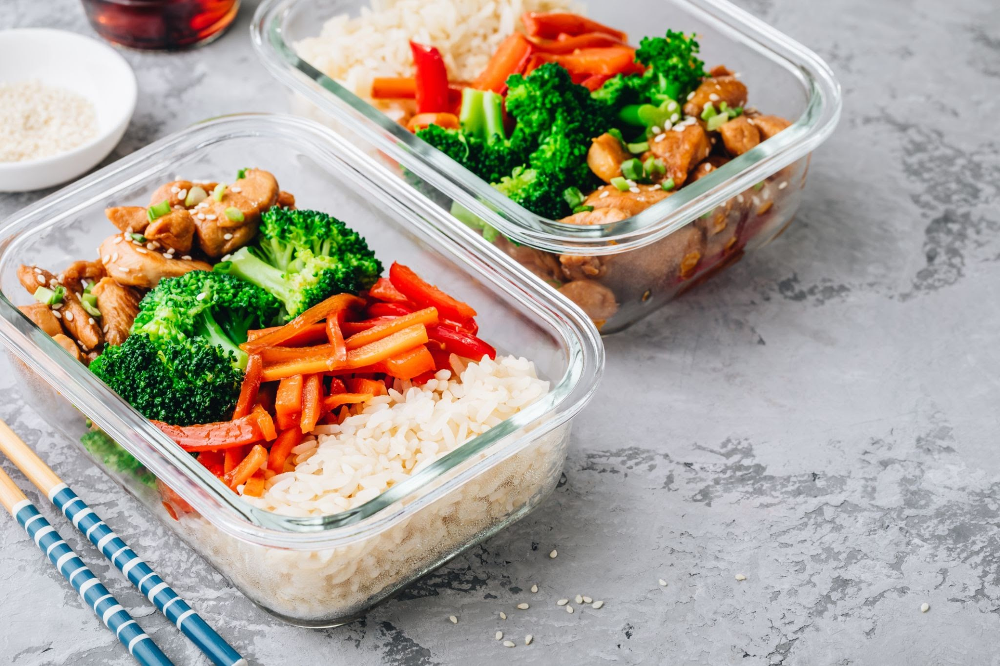

In [18]:
import PIL.Image

img=PIL.Image.open('image.jpg')
img

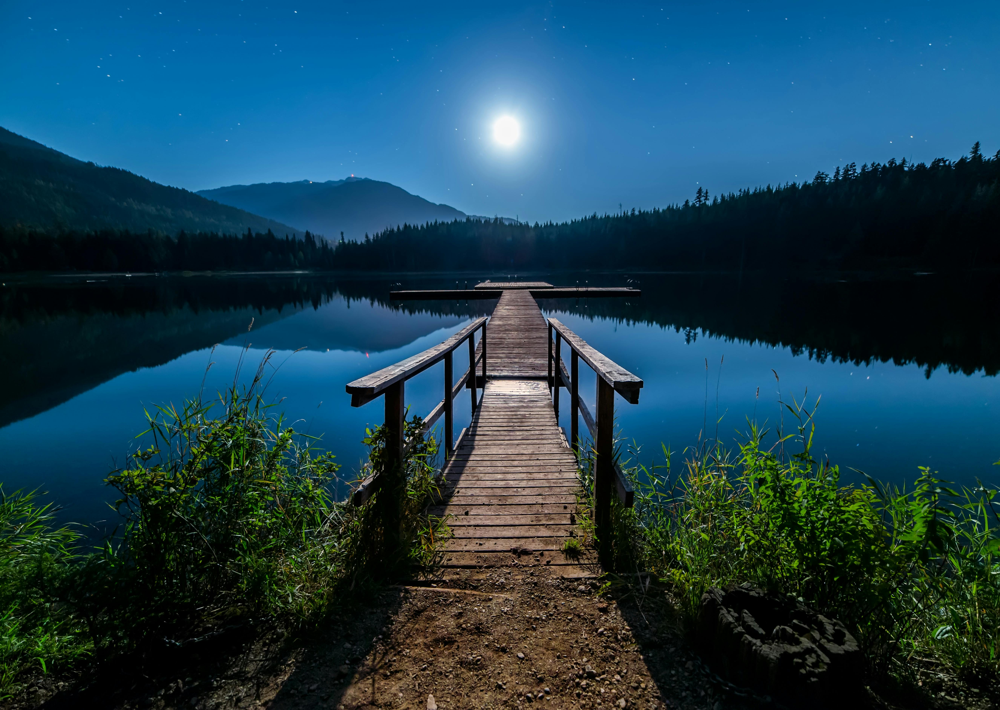

In [19]:
import PIL.Image

img=PIL.Image.open('image2.jpg')
img

In [20]:
model2=genai.GenerativeModel('gemini-pro-vision')

In [21]:
response=model2.generate_content(img)

In [22]:
to_markdown(response.text)

>  The photo is of a dock extending out into a body of water. It is nighttime and the moon is shining brightly. The water is calm and still, reflecting the light of the moon. The sky is dark and starry.

In [23]:
response=model2.generate_content(["Write a short, engaging blog post based on this picture. It should include a description of the meal prepping.",img],stream=True)

In [24]:
response.resolve()

In [25]:
response.text

" There's nothing quite like enjoying a delicious meal in the great outdoors. And when you're camping, it's even better. But if you're not prepared, cooking a meal over the campfire can be a challenge. That's where meal prepping comes in.\n\nBy prepping your meals ahead of time, you can make sure that you have everything you need to cook a delicious meal, even when you're in the middle of nowhere. Plus, it will save you time and hassle so you can spend more time enjoying your camping trip.\n\nHere are a few tips for meal prepping for your next camping trip:\n\n* Choose meals that are easy to cook and don't require a lot of ingredients.\n* Pre-cut your vegetables and meat ahead of time.\n* Marinate your meat or fish in a Ziploc bag before you leave.\n* Pack your food in airtight containers so it stays fresh.\n* Bring a cooler with ice to keep your food cold.\n\nWith a little bit of planning, you can easily enjoy delicious meals on your next camping trip. So what are you waiting for? Get

In [26]:
to_markdown(response.text)

>  There's nothing quite like enjoying a delicious meal in the great outdoors. And when you're camping, it's even better. But if you're not prepared, cooking a meal over the campfire can be a challenge. That's where meal prepping comes in.
> 
> By prepping your meals ahead of time, you can make sure that you have everything you need to cook a delicious meal, even when you're in the middle of nowhere. Plus, it will save you time and hassle so you can spend more time enjoying your camping trip.
> 
> Here are a few tips for meal prepping for your next camping trip:
> 
> * Choose meals that are easy to cook and don't require a lot of ingredients.
> * Pre-cut your vegetables and meat ahead of time.
> * Marinate your meat or fish in a Ziploc bag before you leave.
> * Pack your food in airtight containers so it stays fresh.
> * Bring a cooler with ice to keep your food cold.
> 
> With a little bit of planning, you can easily enjoy delicious meals on your next camping trip. So what are you waiting for? Get started meal prepping today!